In [14]:
# imports 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
from typing import List, Tuple
from PIL import Image

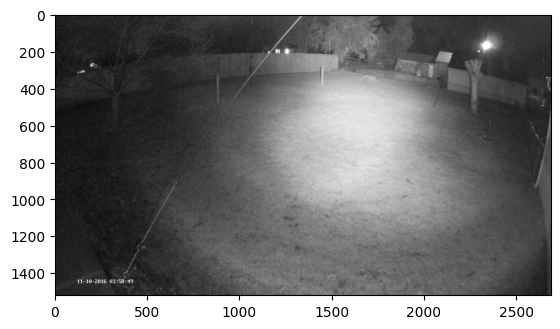

In [15]:
# Load image
image1 = Image.open("test1.png")
image1 = np.array(image1)
image2 = Image.open("test2.png")
image2 = np.array(image1)
image3 = Image.open("test3.png")
image3 = np.array(image1)
image4 = Image.open("test4.jpg")
image4 = np.array(image1)
image5 = Image.open("test5.jpg")
image5 = np.array(image1)
image6 = Image.open("test6.jpg")
image6 = np.array(image1)
image7 = Image.open("test7.png")
image7 = np.array(image1)
plt.imshow(image1, cmap='gray')

In [16]:
image1.dtype, image1.max(), image1.min(), image1.shape

(dtype('uint8'), 255, 0, (1520, 2688))

## 1.Calculate Histograms

#### a. Calculate Histogram

In [17]:
# Calculate histogram of the given 2d array images
def CalculateHistogram(img: np.ndarray) -> np.ndarray:
    """
    Calculate the histogram of a given image.

    Args:
    - img (np.ndarray): The input image.

    Returns:
    - np.ndarray: The histogram of the input image.
    """

    hist = np.zeros(256)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            hist[img[i, j]] += 1
    return hist

hist = CalculateHistogram(image1)
hist 

array([1.9000e+01, 1.3000e+01, 1.1000e+01, 2.8000e+01, 4.4000e+01,
       7.9000e+01, 1.7100e+02, 0.0000e+00, 2.5300e+02, 4.4000e+02,
       6.7500e+02, 1.1510e+03, 1.9270e+03, 3.0930e+03, 0.0000e+00,
       4.5720e+03, 6.8160e+03, 9.3620e+03, 1.2368e+04, 1.6437e+04,
       2.0524e+04, 0.0000e+00, 2.5046e+04, 2.9286e+04, 3.3403e+04,
       3.7391e+04, 4.0691e+04, 4.3937e+04, 0.0000e+00, 4.6650e+04,
       4.8795e+04, 5.0205e+04, 5.1078e+04, 5.2184e+04, 5.1500e+04,
       0.0000e+00, 5.2307e+04, 5.1768e+04, 5.1731e+04, 5.1215e+04,
       5.1748e+04, 5.1797e+04, 0.0000e+00, 5.0913e+04, 5.0056e+04,
       4.9196e+04, 4.7980e+04, 4.7666e+04, 4.6680e+04, 0.0000e+00,
       4.5771e+04, 4.5749e+04, 4.5061e+04, 4.4121e+04, 4.3454e+04,
       4.2043e+04, 0.0000e+00, 4.0884e+04, 3.8631e+04, 3.7224e+04,
       3.5623e+04, 3.4348e+04, 3.3607e+04, 0.0000e+00, 3.2718e+04,
       3.2108e+04, 3.1035e+04, 3.1030e+04, 3.0380e+04, 3.0016e+04,
       0.0000e+00, 2.9920e+04, 2.9781e+04, 2.9135e+04, 2.8804e

#### b. Calculate Cumulative Histogram

In [18]:
# Calculate the cumulative histogram of the given histogram
def CalculateCumulativeHistogram(hist: np.ndarray) -> np.ndarray:
    """
    Calculate the cumulative histogram of a given histogram.

    Args:
    - hist (np.ndarray): The input histogram.

    Returns:
    - np.ndarray: The cumulative histogram.
    """
    cum_hist = np.zeros(256, dtype=np.float64)
    cum_hist[0] = hist[0]
    for i in range(1, 256):
        cum_hist[i] = cum_hist[i-1] + hist[i]
    return cum_hist

cum_hist = CalculateCumulativeHistogram(hist)
cum_hist

array([1.900000e+01, 3.200000e+01, 4.300000e+01, 7.100000e+01,
       1.150000e+02, 1.940000e+02, 3.650000e+02, 3.650000e+02,
       6.180000e+02, 1.058000e+03, 1.733000e+03, 2.884000e+03,
       4.811000e+03, 7.904000e+03, 7.904000e+03, 1.247600e+04,
       1.929200e+04, 2.865400e+04, 4.102200e+04, 5.745900e+04,
       7.798300e+04, 7.798300e+04, 1.030290e+05, 1.323150e+05,
       1.657180e+05, 2.031090e+05, 2.438000e+05, 2.877370e+05,
       2.877370e+05, 3.343870e+05, 3.831820e+05, 4.333870e+05,
       4.844650e+05, 5.366490e+05, 5.881490e+05, 5.881490e+05,
       6.404560e+05, 6.922240e+05, 7.439550e+05, 7.951700e+05,
       8.469180e+05, 8.987150e+05, 8.987150e+05, 9.496280e+05,
       9.996840e+05, 1.048880e+06, 1.096860e+06, 1.144526e+06,
       1.191206e+06, 1.191206e+06, 1.236977e+06, 1.282726e+06,
       1.327787e+06, 1.371908e+06, 1.415362e+06, 1.457405e+06,
       1.457405e+06, 1.498289e+06, 1.536920e+06, 1.574144e+06,
       1.609767e+06, 1.644115e+06, 1.677722e+06, 1.6777

## 2. Analyze Histogram

#### a. GetColorAtPercentage

In [19]:
# Get Color At Percentage
def GetColorAtPercentage(cum_hist: np.ndarray, percentage: float) -> Tuple[int, int]:
    """
    Get the intensities that cover the given percentage of the image.

    Args:
    - cum_hist (np.ndarray): The cumulative histogram of the image.
    - percentage (float): The percentage of the image to cover.

    Returns:
    - Tuple[int, int]: The intensities that cover the given percentage of the image.
    """
    assert percentage >= 0 and percentage <= 100, "Percentage should be between 0 and 100."
    min_intensity_at_percentage = None
    cum_hist_percent = (cum_hist / cum_hist[-1]) * 100

    for i in range(256):
        curr_percent = cum_hist_percent[i]
        if curr_percent >= percentage:
            min_intensity_at_percentage = i
            break

    max_intensity_at_percentage = None
    for i in range(256):
        curr_percent = cum_hist_percent[i]
        if curr_percent >= 100-percentage:
            max_intensity_at_percentage = i
            break

    return min_intensity_at_percentage, max_intensity_at_percentage

GetColorAtPercentage(cum_hist, 5)

(26, 202)

#### b. GetColorsAtMaxSlope

In [20]:
# Get Color At MaxSlope
def GetColorAtMaxSlope(cum_hist: np.ndarray) -> Tuple[int, int]:
    """
    Get the intensities that have the maximum slope-like score.

    Args:
    - cum_hist (np.ndarray): The cumulative histogram of the image.

    Returns:
    - Tuple[int, int]: The intensities that have the maximum slope-like score.
    """

    max_slope_like_score = float('-inf')
    intensities = (-1,-1)
    for i in range(256):
        for j in range(i+1, 256):
            slope_like_score = (cum_hist[j] - cum_hist[i])**4 / (j - i)
            if slope_like_score > max_slope_like_score:
                max_slope_like_score = slope_like_score
                intensities = (i, j)
    return intensities

GetColorAtMaxSlope(cum_hist)

(15, 225)

## 3. Modify Histogram

#### a. Stretch Contrast

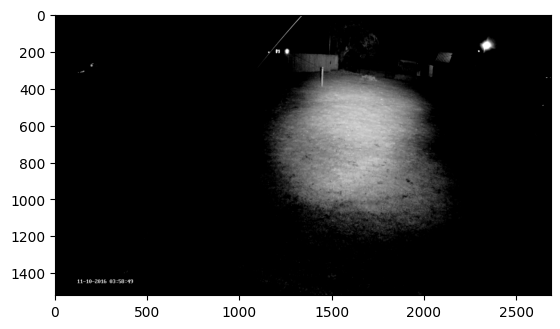

In [21]:
# Stretch Contrast
def StretchContrast(img: np.ndarray, a: int, b: int, c: int, d: int) -> np.ndarray:
    """
    Stretch the contrast of the image in range [c,d] to the range [a, b].

    Args:
    - img: The input image.
    - a: The lower bound of the output range.
    - b: The upper bound of the output range.
    - c: The lower bound of the input range.
    - d: The upper bound of the input range.

    Returns:
    - np.ndarray: The contrast stretched image
    """

    scale_factor = (b-a)/(d-c)
    img_float = np.array(img, dtype=np.float64)
    new_img = (img_float - c) * scale_factor + a
    new_img = np.clip(new_img, a, b)
    return np.array(new_img, dtype=np.uint8)

stretched_image = StretchContrast(image1, 0, 255, 128, 255)
plt.imshow(stretched_image, cmap='gray')

#### b. EqualizeHistogram

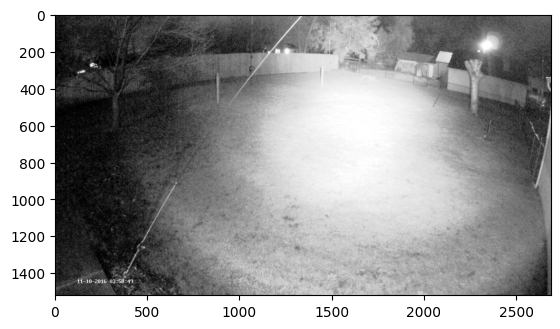

In [22]:
# Equalize Histogram
def EqualizeHistogram(img: np.ndarray, a: int, b: int) -> np.ndarray:
    """
    Equalize the histogram of the image using the given range [a, b].
    """
    hist = CalculateHistogram(img)
    f = CalculateCumulativeHistogram(hist)
    f_min = f[a]
    num_of_pixels = f[b]
    equalized_intensities = (f - f_min)/(num_of_pixels - f_min) * (255-0) + 0
    equalized_intensities = np.round(equalized_intensities)
    equalized_img = equalized_intensities[img]
    equalized_img = np.clip(equalized_img, 0, 255)
    return np.array(equalized_img, dtype=np.uint8)

equalized_image = EqualizeHistogram(image1, 0, 255)
plt.imshow(equalized_image, cmap='gray')

## Helper Functions for Testing

In [23]:
# We made it in case np.clip is unallowed but did not use it yet
def clip(img: np.ndarray, a: int, b: int) -> np.ndarray:
    """
    Clip the image to the range [a, b].

    Args:
    - img: The input image.
    - a: The lower bound of the range.
    - b: The upper bound of the range.

    Returns:
    - np.ndarray: The clipped image.
    """
    new_img = np.zeros_like(img, dtype=img.dtype)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            new_img[i, j] = max(a, min(img[i, j], b))
    return new_img

# We made it in case equalized_intensities[img] is unallowed but did not use it yet
def assign_equalized_intensities(img: np.ndarray, equalized_intensities: np.ndarray) -> np.ndarray:
    """
    Assign the equalized intensities to the image.

    Args:
    - img: The input image.
    - equalized_intensities: The equalized intensities.

    Returns:
    - np.ndarray: The image with equalized intensities.
    """
    equalized_img = np.zeros_like(img, dtype=img.dtype)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            equalized_img[i, j] = equalized_intensities[img[i, j]]
    return equalized_img

def read_image(path: str, grayscale: bool = True) -> np.ndarray:
    """
    Reads an image from the specified path and converts it to a NumPy array.
    
    Parameters:
    - path (str): The file path to the image.
    - grayscale (bool): If True, converts the image to grayscale.
    
    Returns:
    - np.ndarray: The image as a NumPy array.
    """
    img = Image.open(path)
    
    if grayscale:
        img = img.convert('L')
    
    img = np.array(img, dtype=np.uint8)
    
    return img
    

def plot_image_and_histograms(img: np.ndarray, hist: np.ndarray, cum_hist: np.ndarray, img_title: str = "Image", hist_title: str = "Histogram", cum_hist_title: str = "Cumulative Histogram") -> None:
    """
    Plots an image, its histogram, and cumulative histogram side-by-side.

    Parameters:
    - img (np.ndarray): The image to display.
    - hist (np.ndarray): The histogram of the image.
    - cum_hist (np.ndarray): The cumulative histogram of the image.
    - img_title (str): Title for the image plot.
    - hist_title (str): Title for the histogram plot.
    - cum_hist_title (str): Title for the cumulative histogram plot.
    """
    fig, axs = plt.subplots(1, 3, figsize=(18, 8), gridspec_kw={'width_ratios': [1.5, 1, 1]})
    
    axs[0].imshow(img, cmap="gray")
    axs[0].set_title(img_title)
    axs[0].axis("off")
    
    axs[1].bar(range(256), hist, color='black')
    axs[1].set_title(hist_title)
    axs[1].set_xlabel("Intensity")
    axs[1].set_ylabel("Frequency")
    
    axs[2].plot(range(256), cum_hist, color='blue')
    axs[2].set_title(cum_hist_title)
    axs[2].set_xlabel("Intensity")
    axs[2].set_ylabel("Cumulative Frequency")
    
    plt.tight_layout()
    plt.show()


def test(img_path: str, percentages: List[int], a: int, b: int) -> None:
    """
    Tests the functions implemented in this notebook.

    Parameters:
    - img_path (str): Path to the image to test.
    - percentages (List[int]): List of percentages to test.
    - a (int): Lower bound for the intensity range.
    - b (int): Upper bound for the intensity range.
    """
    
    img = read_image(img_path)
    hist = CalculateHistogram(img)
    cum_hist = CalculateCumulativeHistogram(hist)
    plot_image_and_histograms(img=img, hist=hist, cum_hist=cum_hist, img_title="Original Image", hist_title="Original Histogram", cum_hist_title="Original Cumulative Histogram")
    all_pairs = []
    for percentage in percentages:
        min_percent_intensity, max_percent_intensity = GetColorAtPercentage(cum_hist, percentage)
        print(f"Intensities covering {percentage}% of the image: {min_percent_intensity} - {max_percent_intensity}")
        all_pairs.append((min_percent_intensity, max_percent_intensity))
    min_slope_intensity, max_slope_intensity = GetColorAtMaxSlope(cum_hist)
    all_pairs.append((min_slope_intensity, max_slope_intensity))
    print(f"Intenities with maximum slope-like score: {min_slope_intensity} - {max_slope_intensity}")

    for pair in all_pairs:
        c, d = pair
        stretched_img = StretchContrast(img=img, a=a, b=b, c=c, d=d)
        stretched_hist = CalculateHistogram(stretched_img)
        stretched_cum_hist = CalculateCumulativeHistogram(stretched_hist)
        plot_image_and_histograms(img=stretched_img, hist=stretched_hist, cum_hist=stretched_cum_hist, img_title=f"Stretched Image (a=0, b=255, c={c}, d={d})", hist_title=f"Stretched Histogram (a=0, b=255, c={c}, d={d})", cum_hist_title=f"Stretched Cumulative Histogram (a=0, b=255, c={c}, d={d})")

        equalized_img = EqualizeHistogram(img=img, a=c, b=d)
        equalized_hist = CalculateHistogram(equalized_img)
        equalized_cum_hist = CalculateCumulativeHistogram(equalized_hist)
        plot_image_and_histograms(img=equalized_img, hist=equalized_hist, cum_hist=equalized_cum_hist, img_title=f"Equalized Image from range ({c}-{d}) to range (a=0, b=255)", hist_title=f"Equalized Histogram from range ({c}-{d}) to range (a=0, b=255)", cum_hist_title=f"Equalized Cumulative Histogram from range ({c}-{d}) to range (a=0, b=255)")


## Testing

In [24]:
# Parameters
a = 0
b = 255
percentages = [5,10,15]

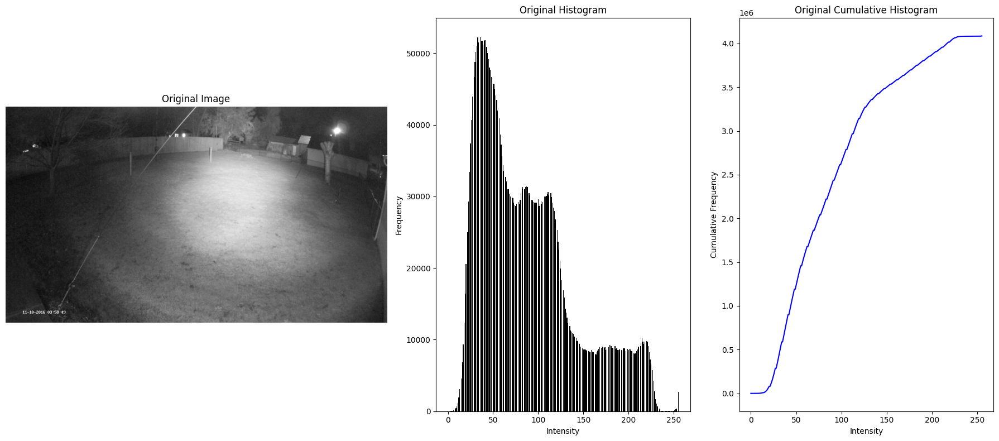

Intensities covering 5% of the image: 26 - 202
Intensities covering 10% of the image: 31 - 174
Intensities covering 15% of the image: 36 - 146
Intenities with maximum slope-like score: 15 - 225


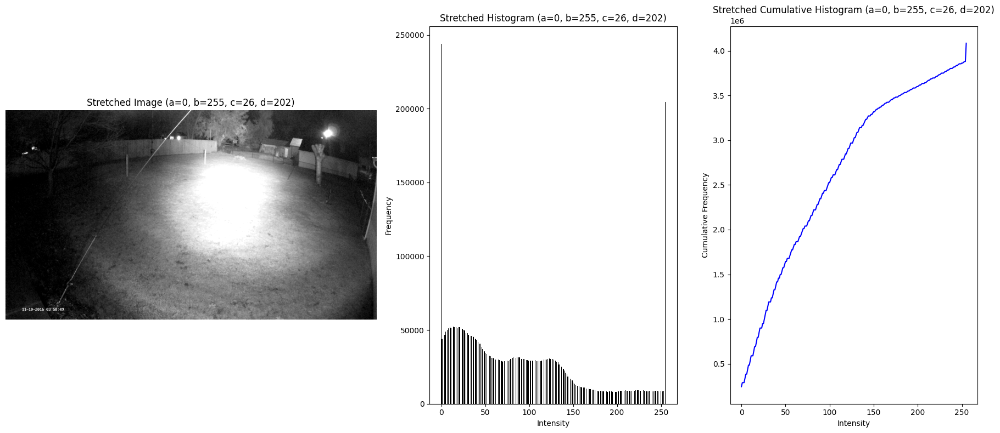

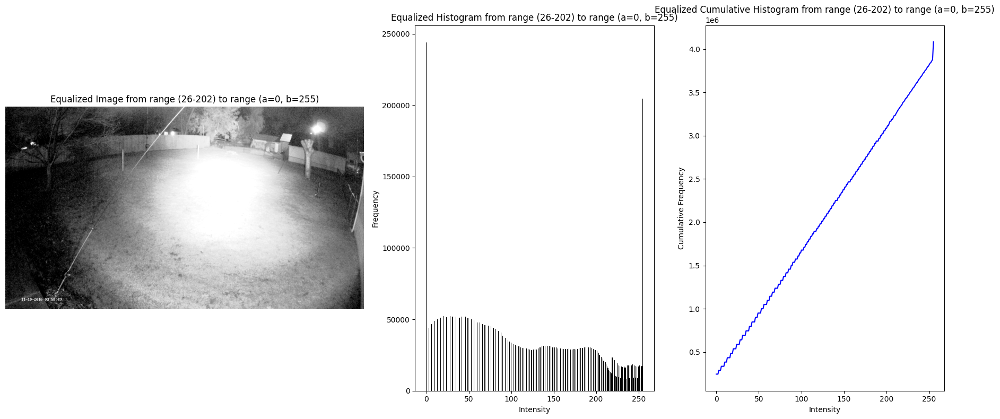

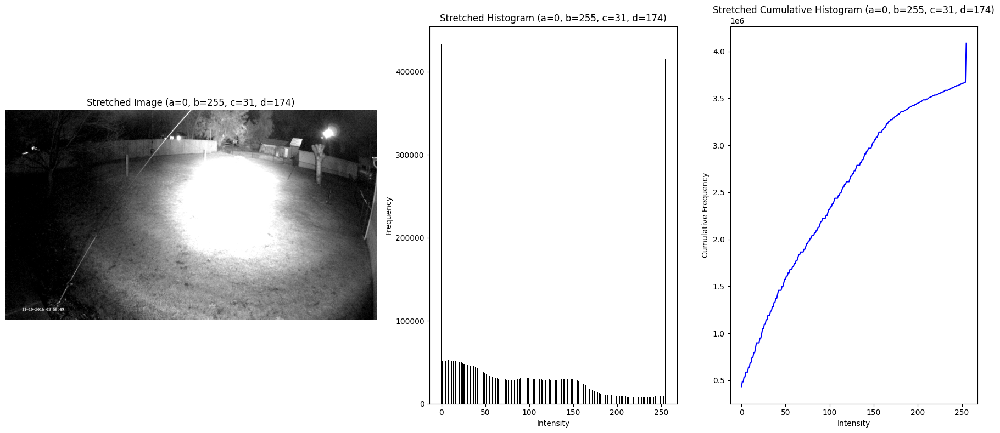

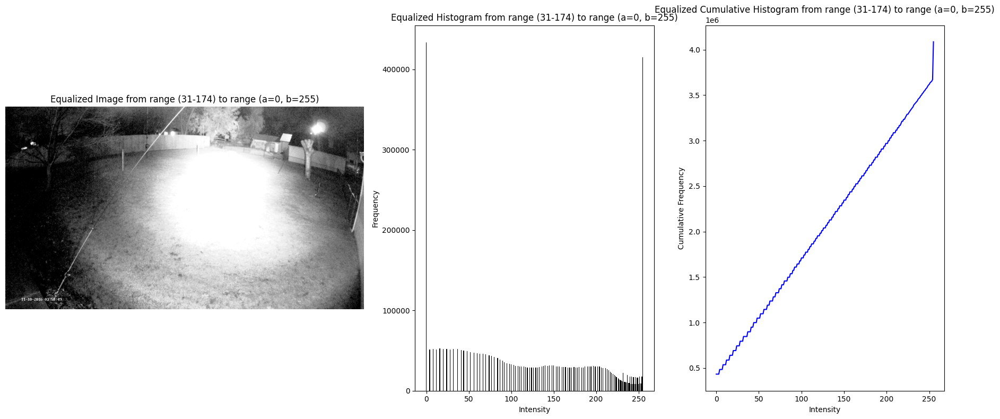

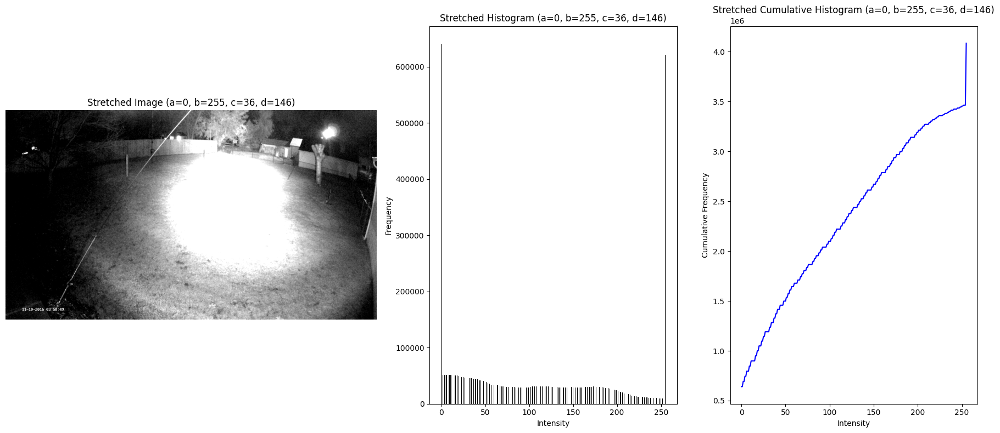

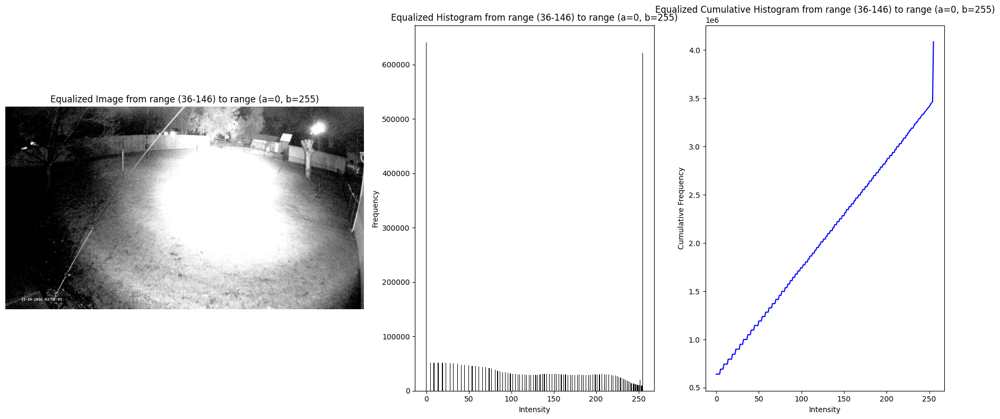

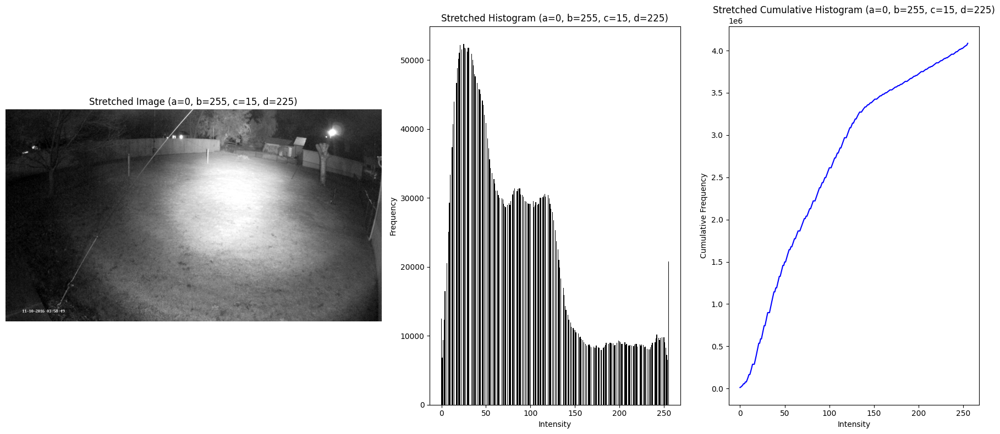

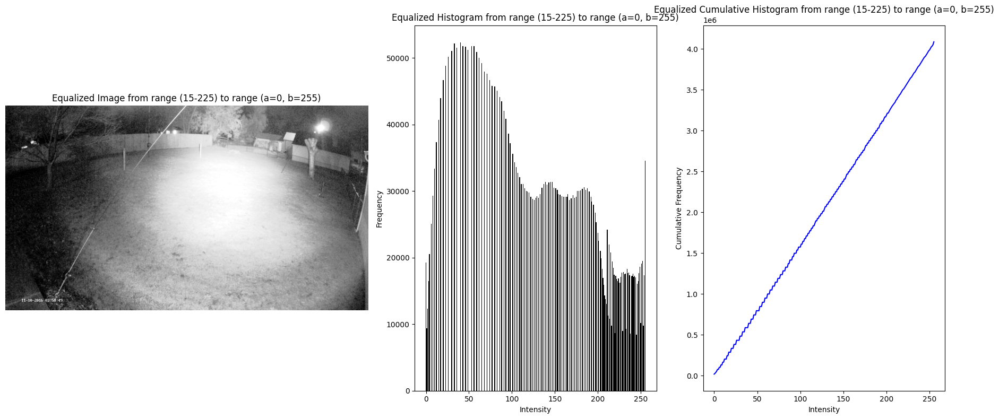

In [25]:
# Test image 1
test(img_path='./test1.png', percentages=percentages, a=a, b=b)

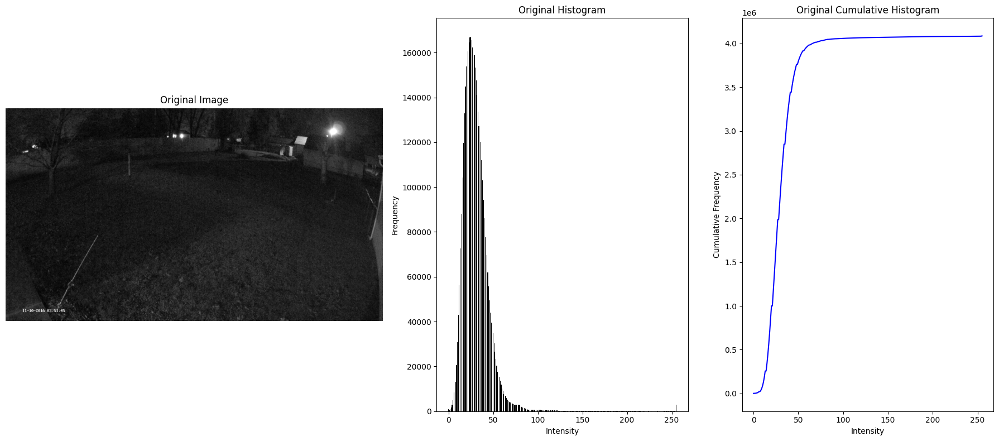

Intensities covering 5% of the image: 13 - 54
Intensities covering 10% of the image: 16 - 46
Intensities covering 15% of the image: 18 - 43
Intenities with maximum slope-like score: 9 - 53


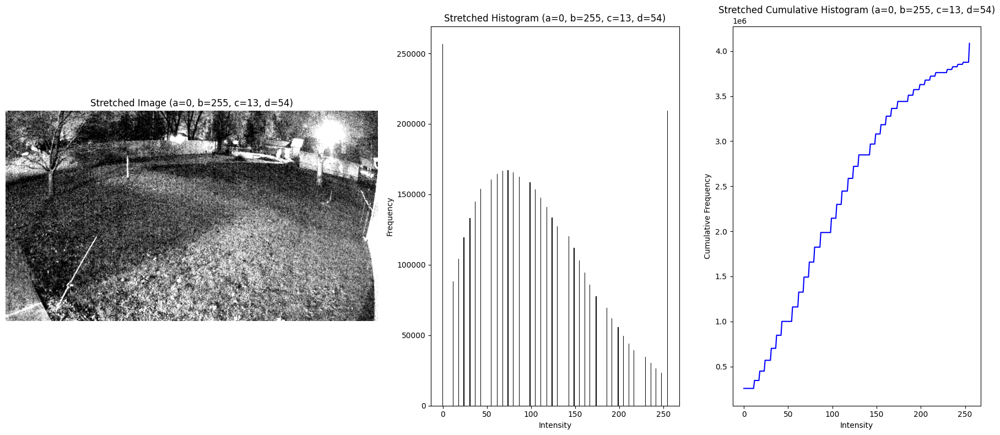

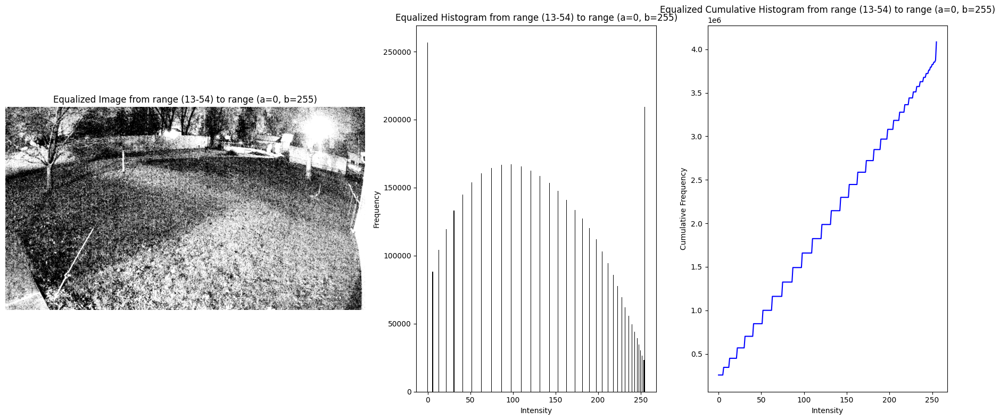

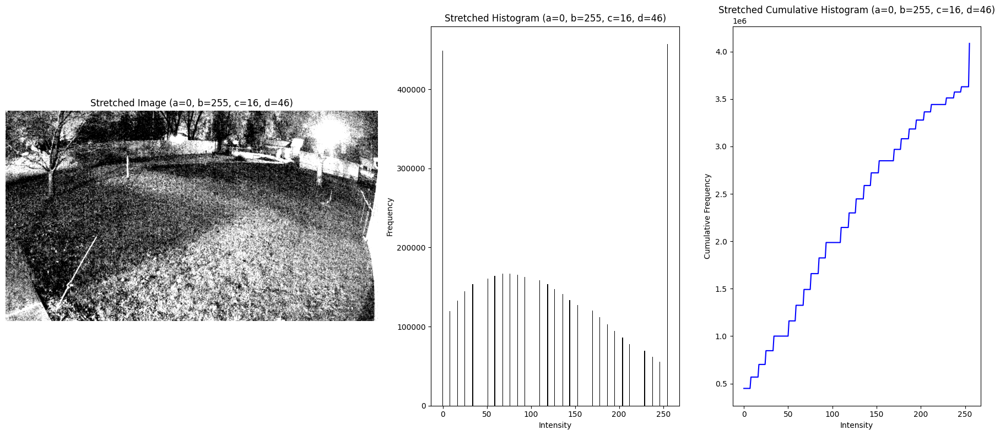

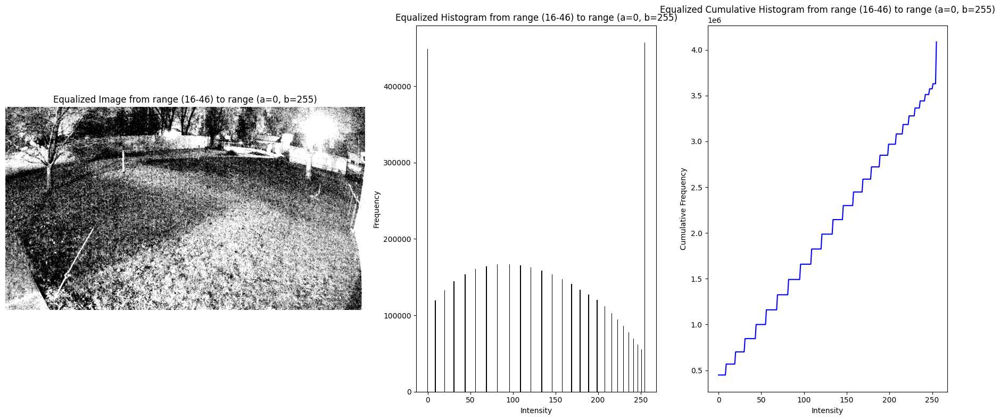

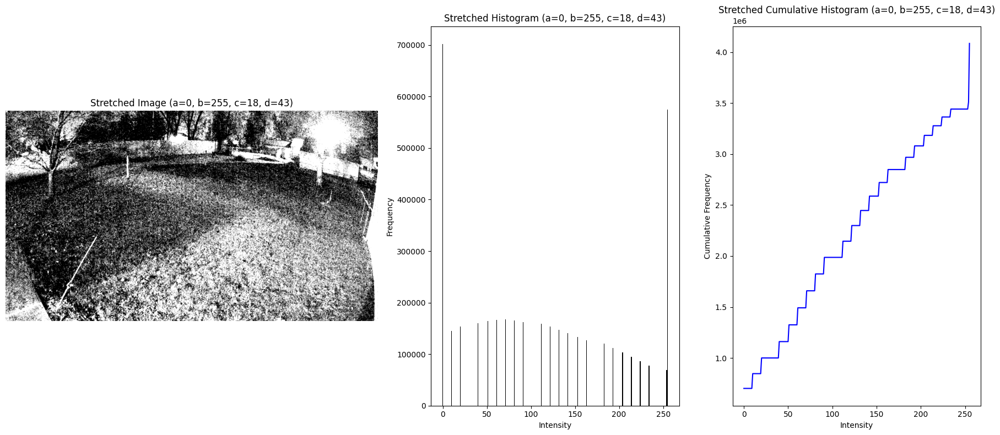

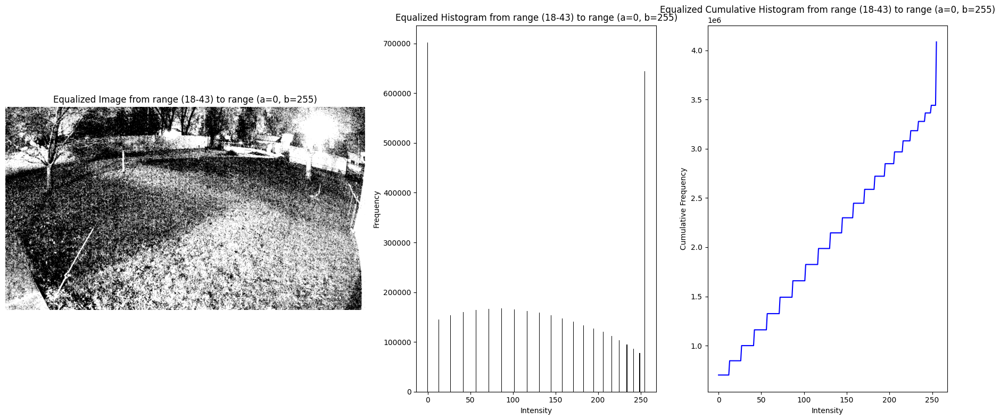

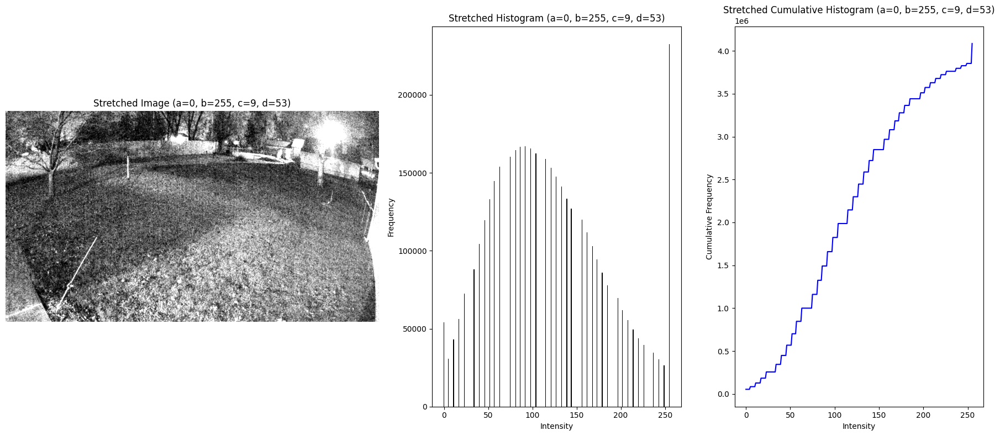

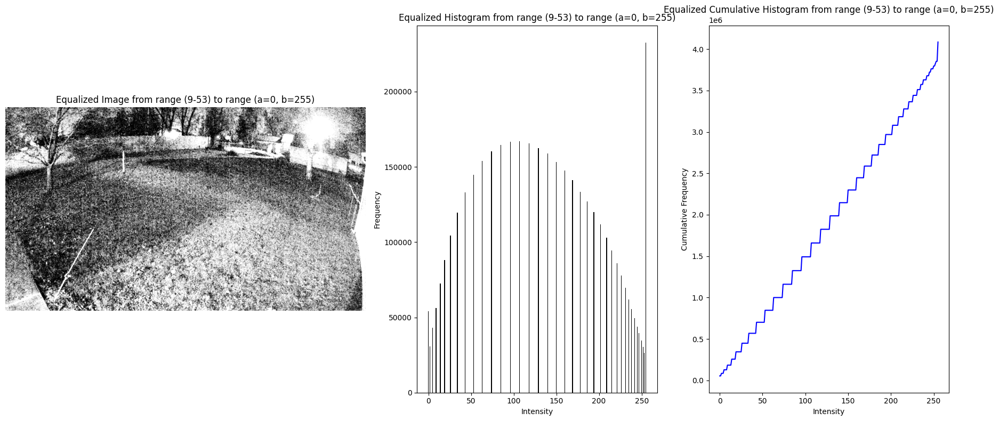

In [26]:
# Test image 2
test(img_path='./test2.png', percentages=percentages, a=a, b=b)

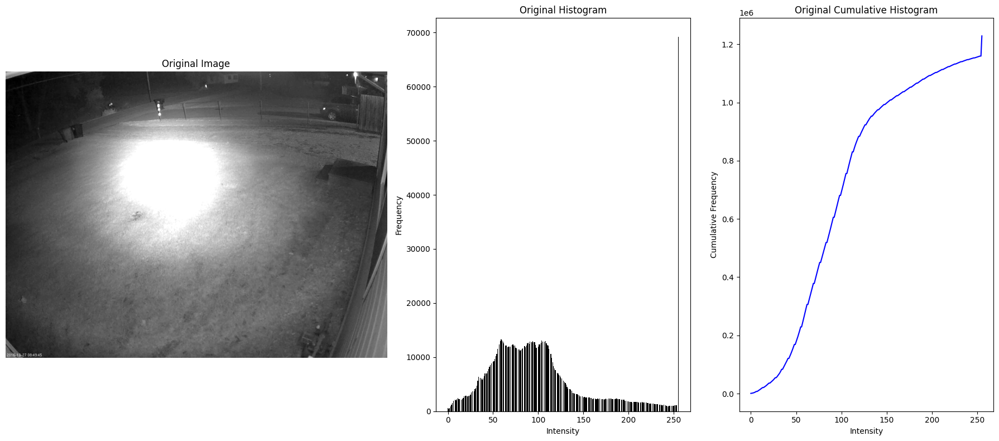

Intensities covering 5% of the image: 30 - 255
Intensities covering 10% of the image: 43 - 207
Intensities covering 15% of the image: 51 - 173
Intenities with maximum slope-like score: 7 - 255


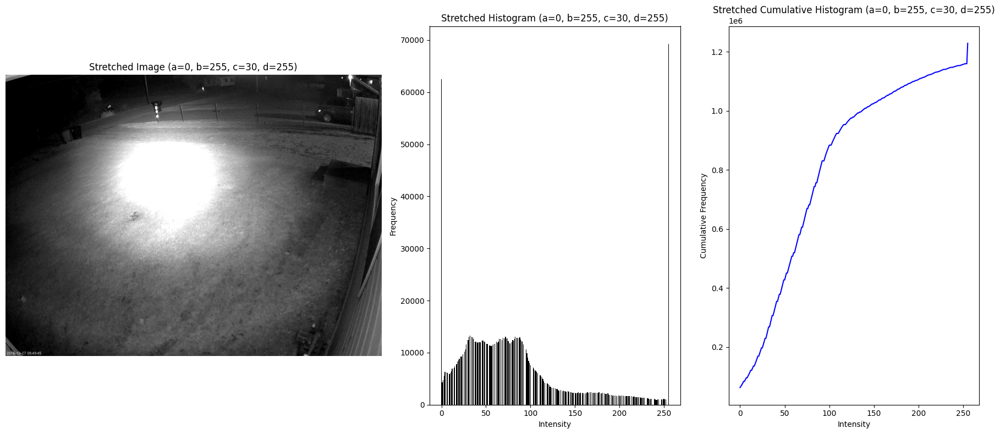

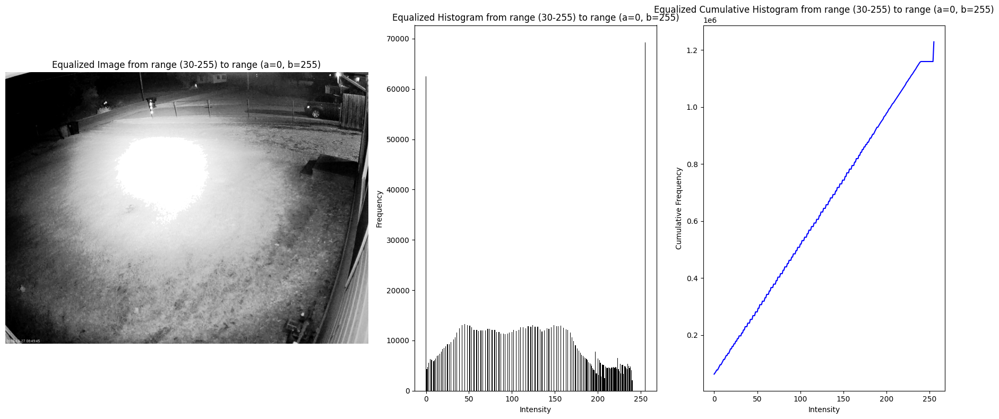

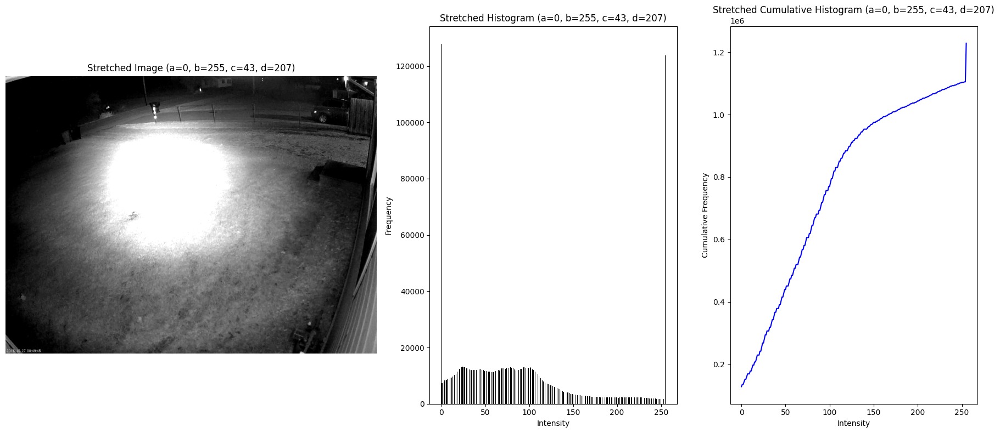

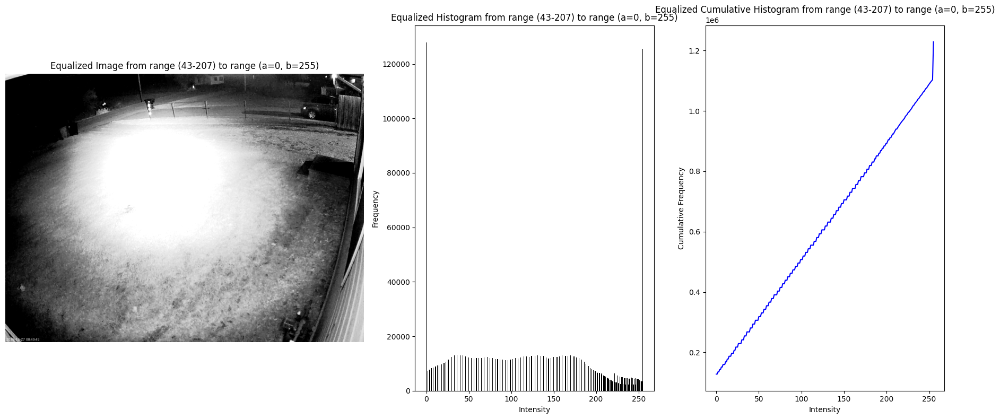

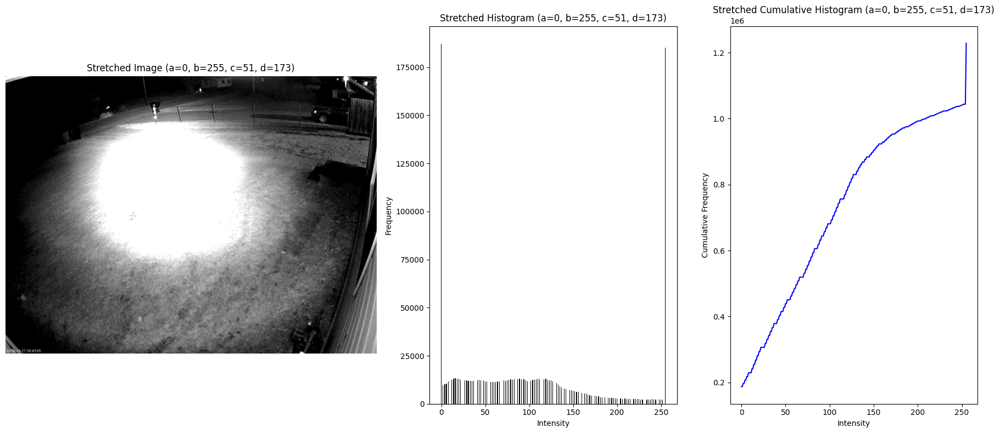

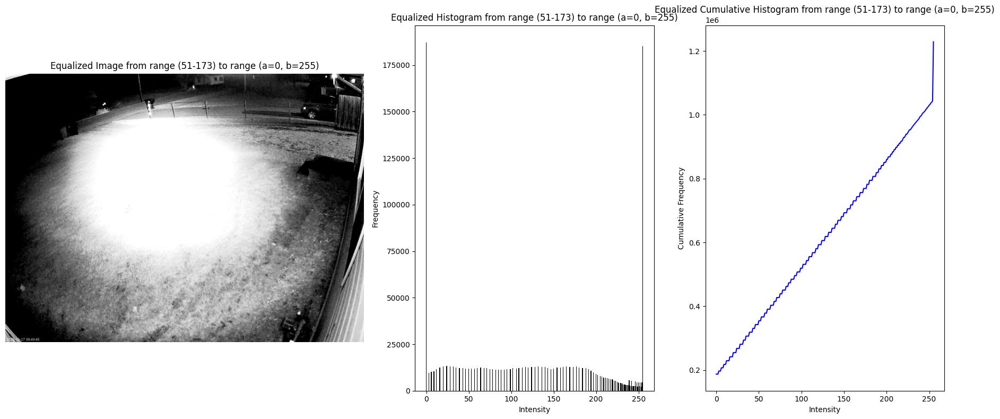

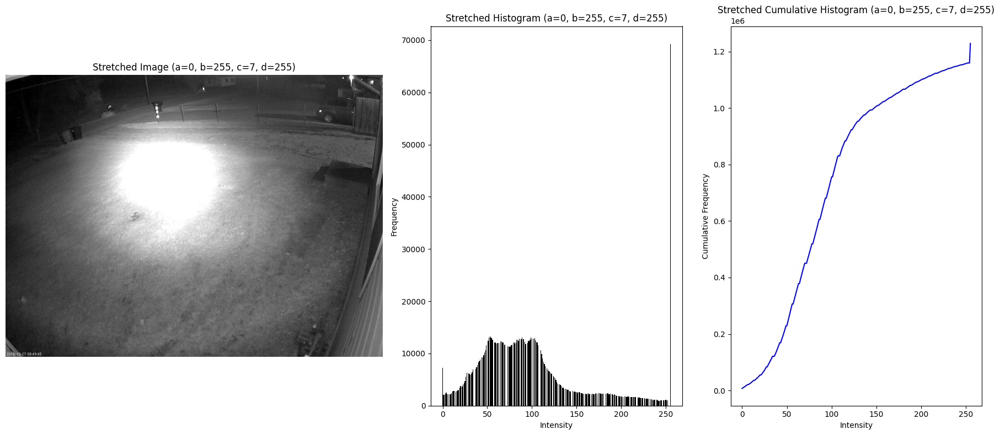

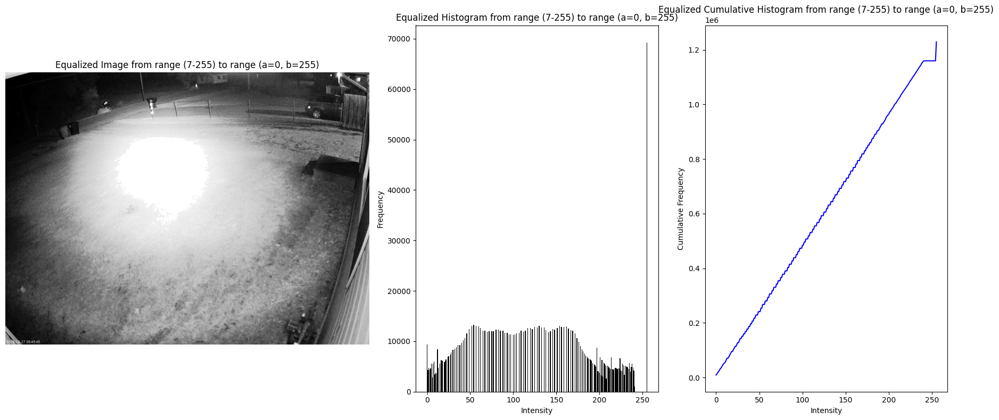

In [27]:
# Test image 3
test(img_path='./test3.png', percentages=percentages, a=a, b=b)

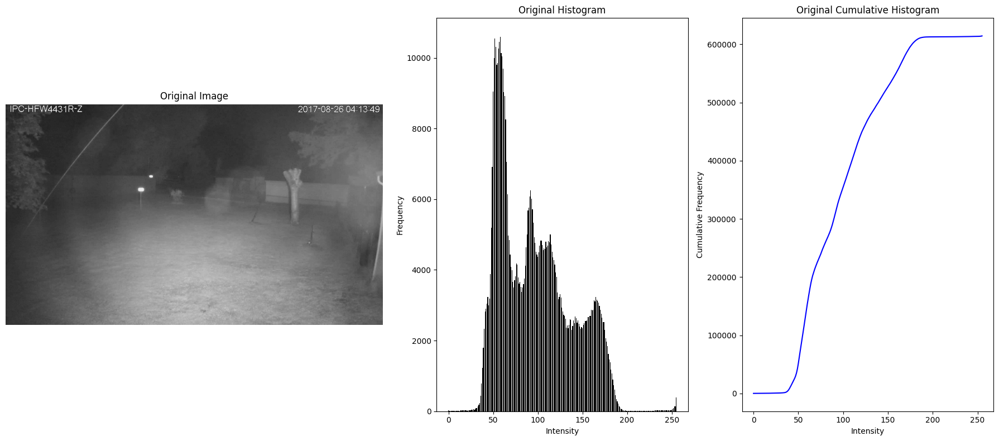

Intensities covering 5% of the image: 48 - 171
Intensities covering 10% of the image: 52 - 160
Intensities covering 15% of the image: 55 - 149
Intenities with maximum slope-like score: 37 - 183


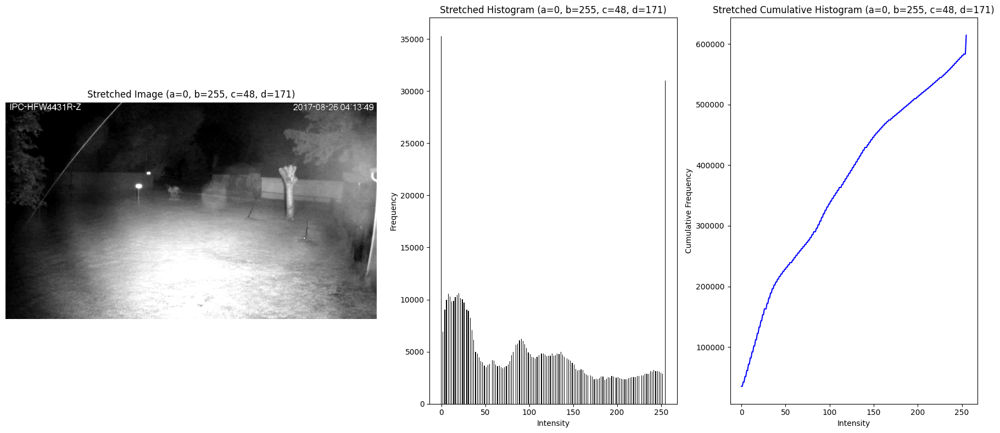

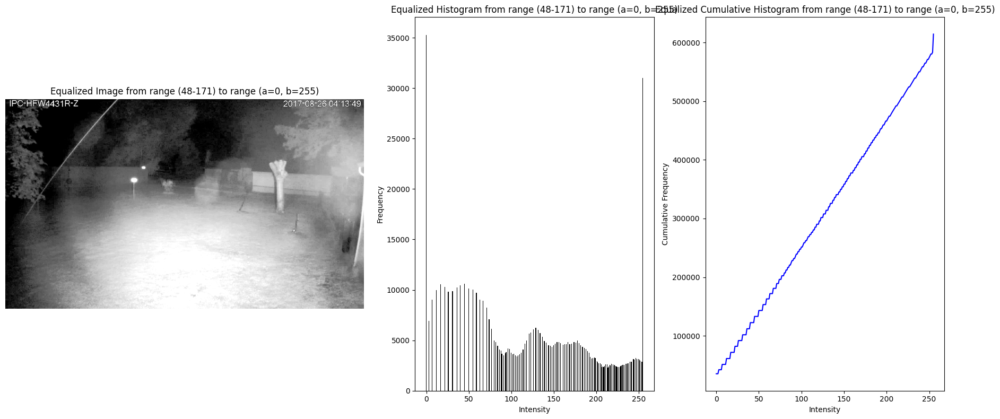

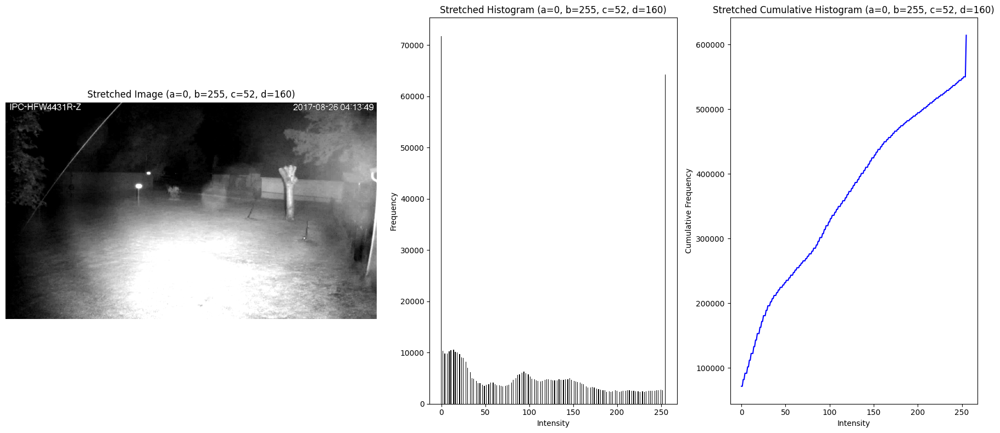

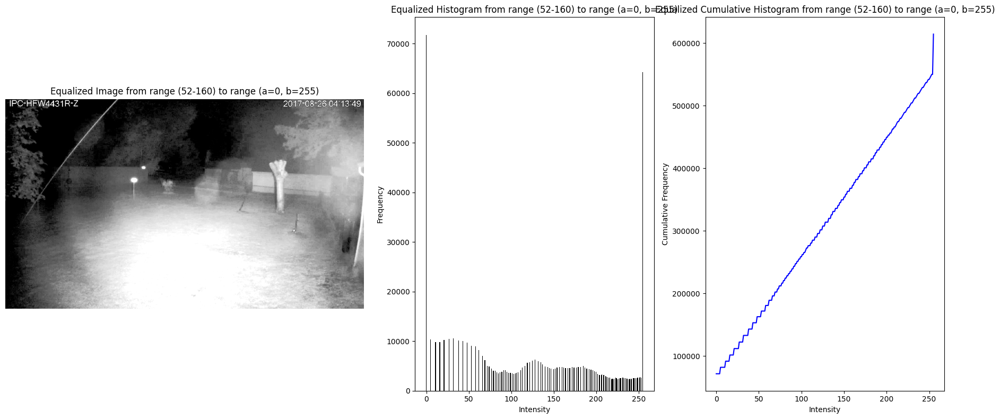

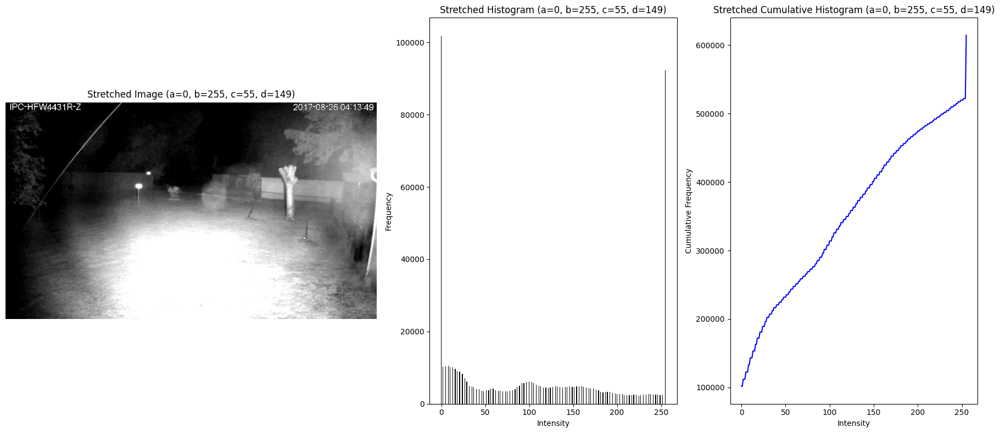

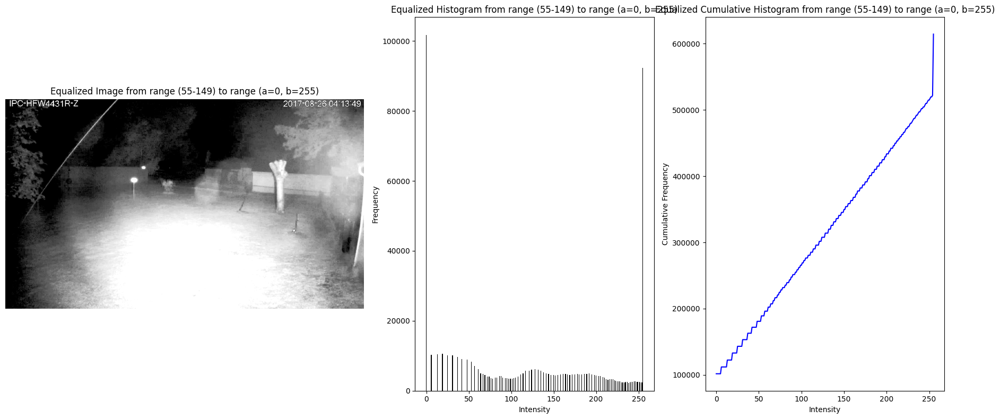

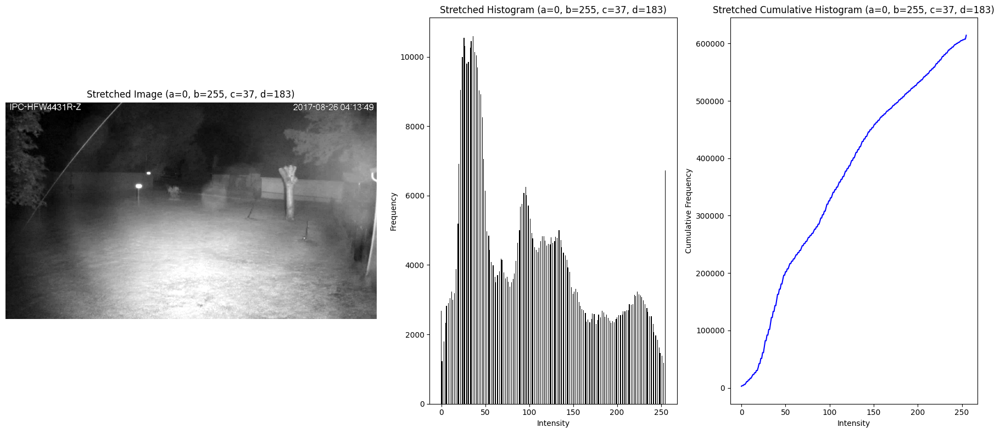

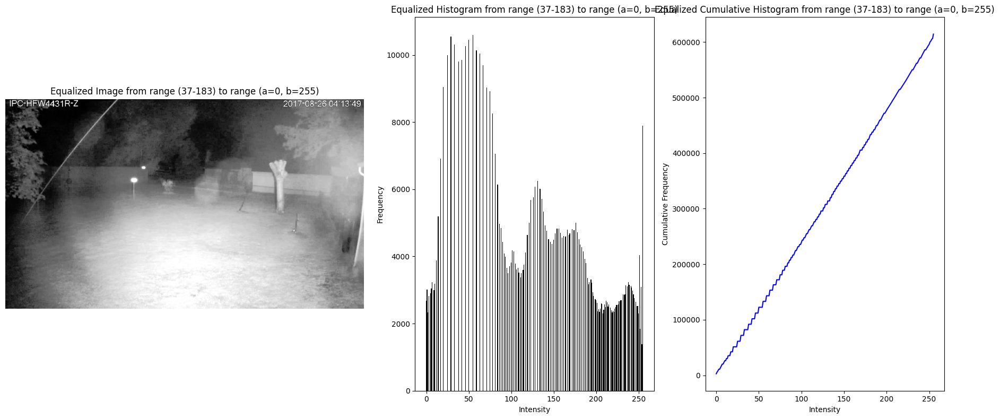

In [28]:
# Test image 4
test(img_path='./test4.jpg', percentages=percentages, a=a, b=b)

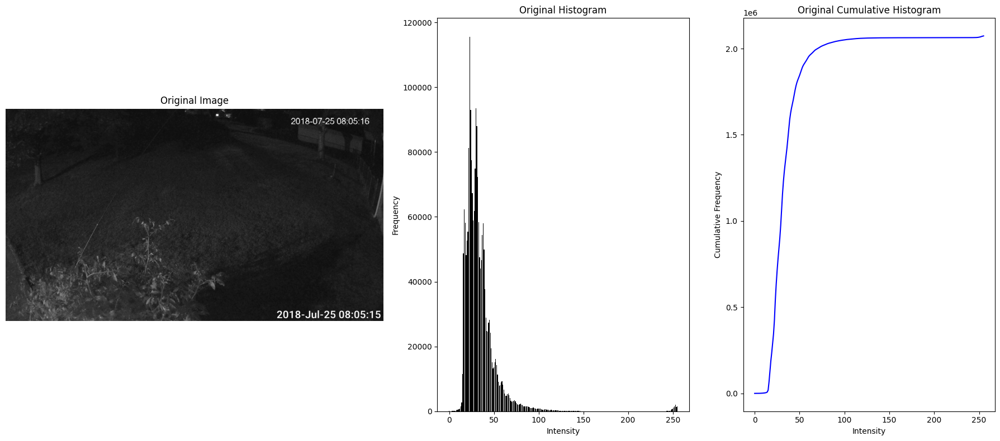

Intensities covering 5% of the image: 17 - 64
Intensities covering 10% of the image: 19 - 52
Intensities covering 15% of the image: 21 - 46
Intenities with maximum slope-like score: 15 - 53


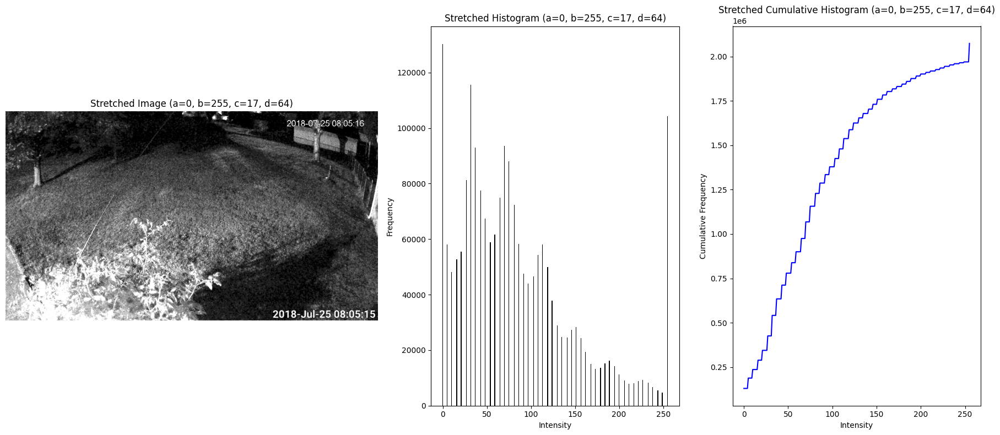

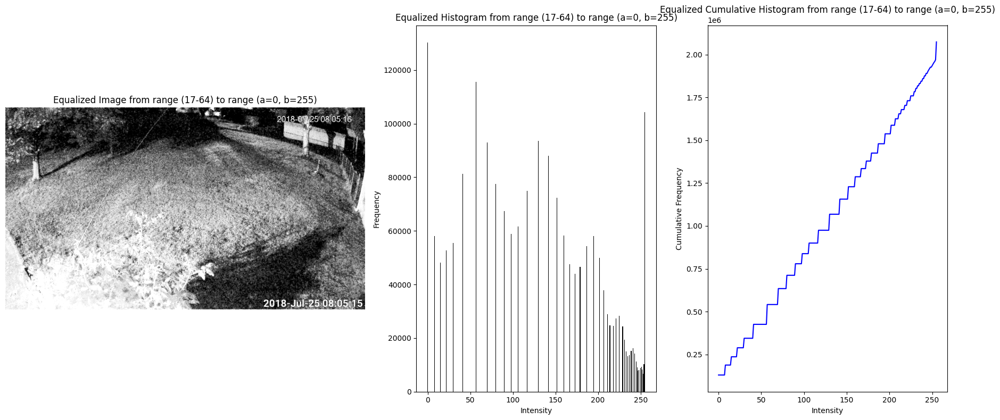

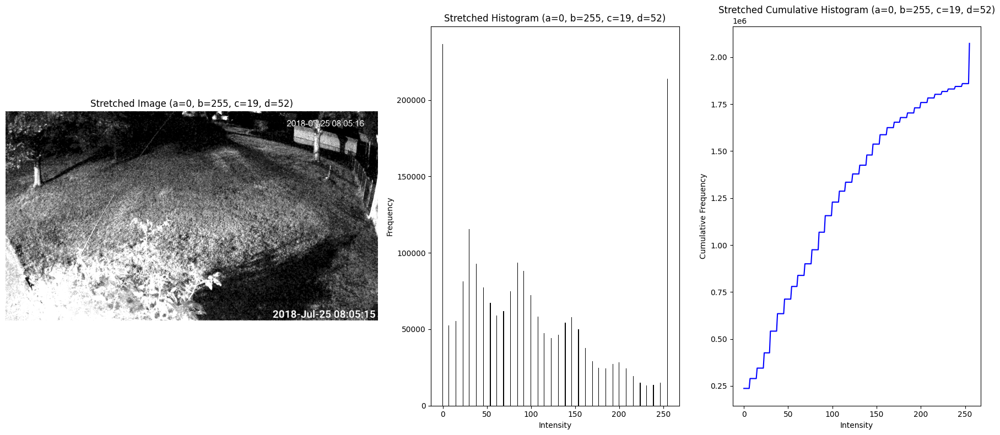

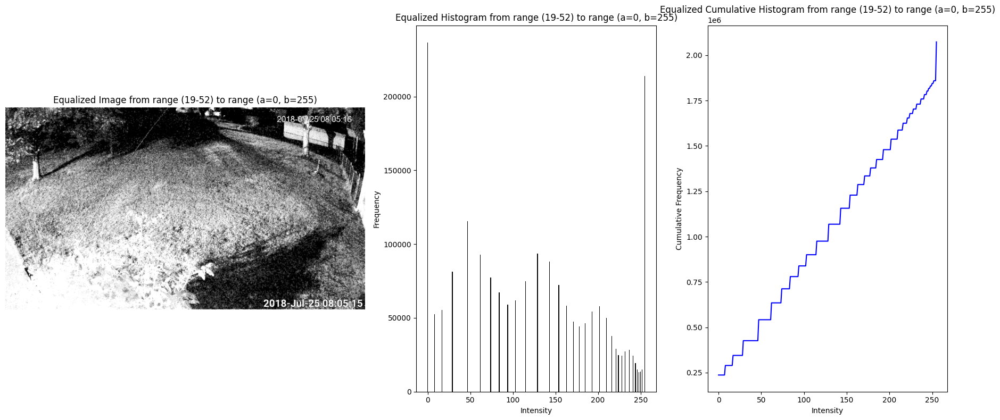

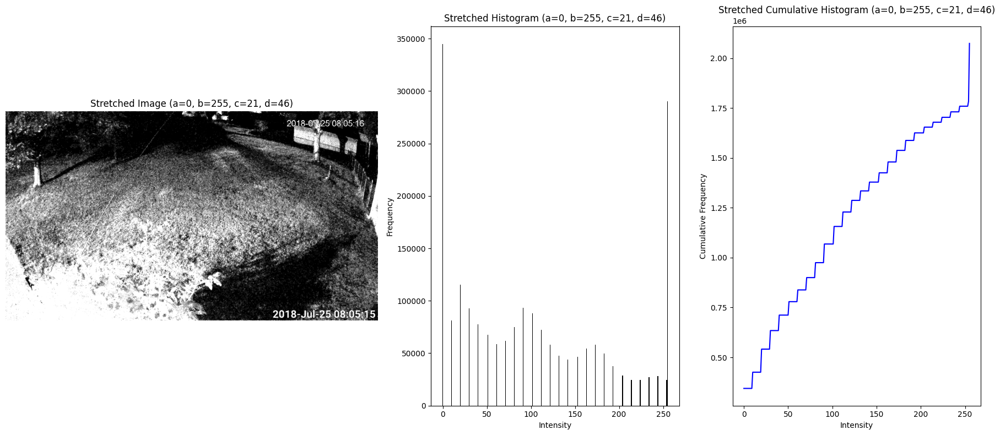

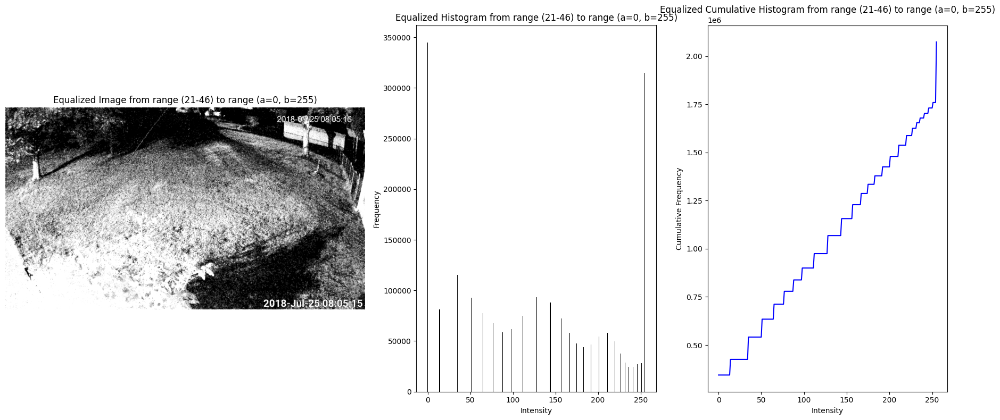

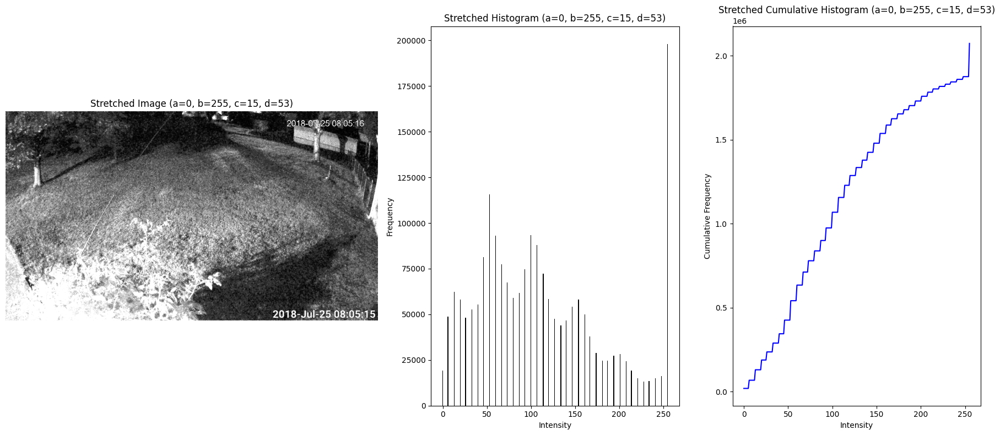

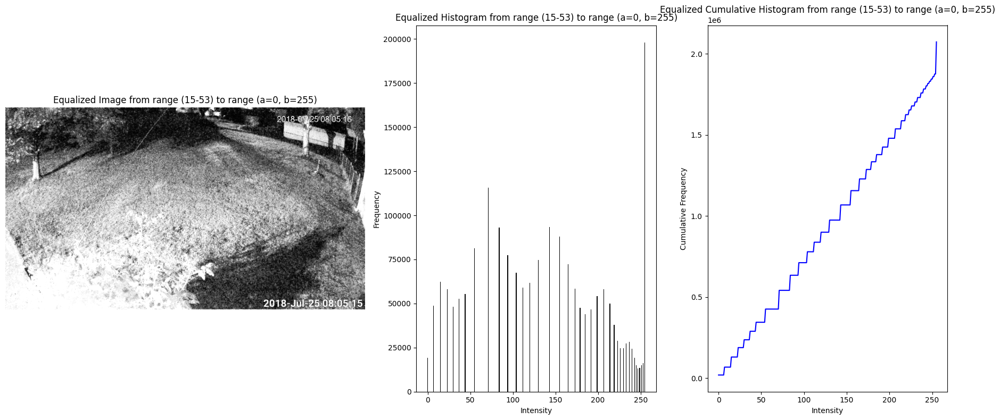

In [29]:
# Test image 5
test(img_path='./test5.jpg', percentages=percentages, a=a, b=b)

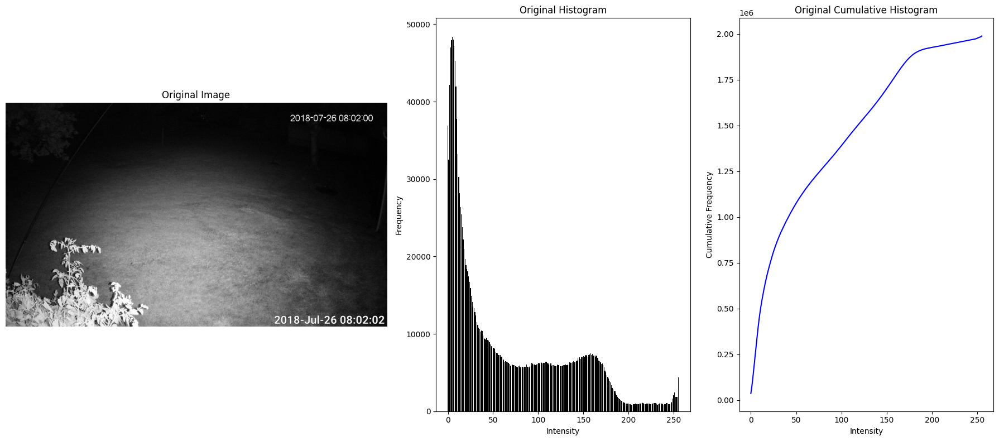

Intensities covering 5% of the image: 2 - 180
Intensities covering 10% of the image: 4 - 163
Intensities covering 15% of the image: 6 - 149
Intenities with maximum slope-like score: 0 - 185


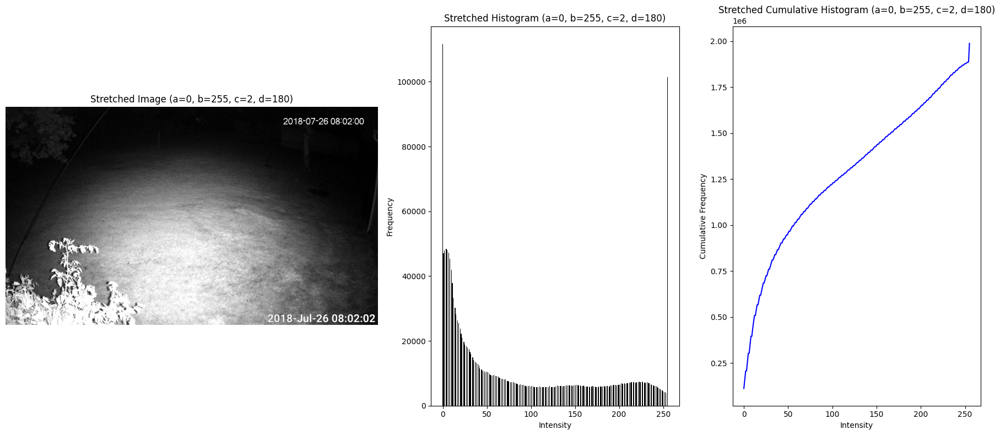

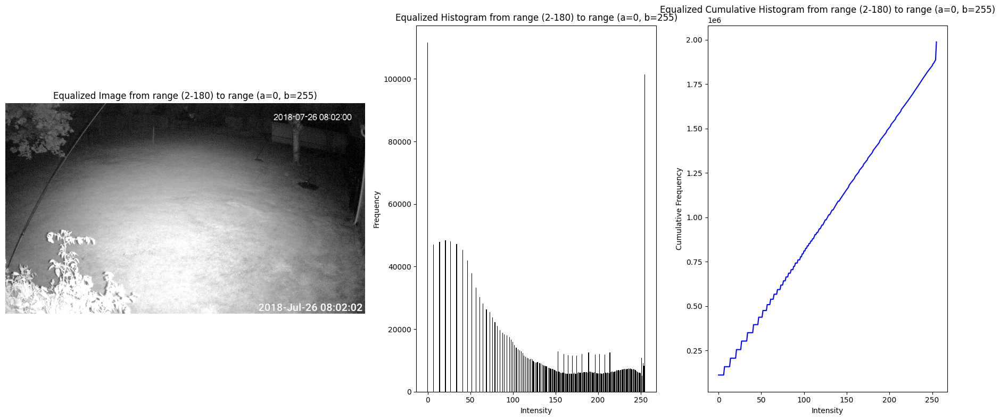

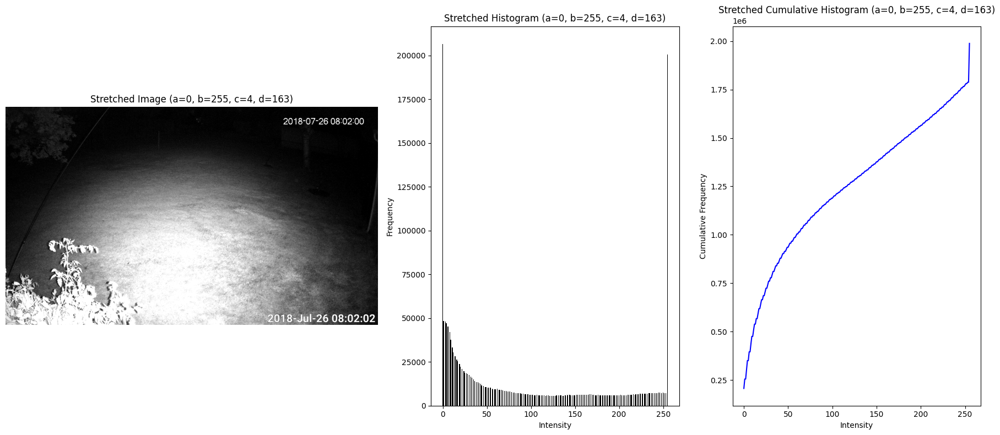

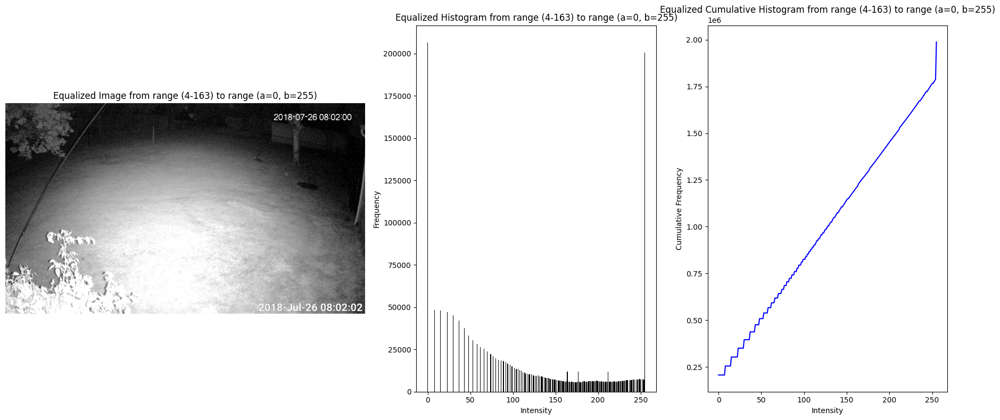

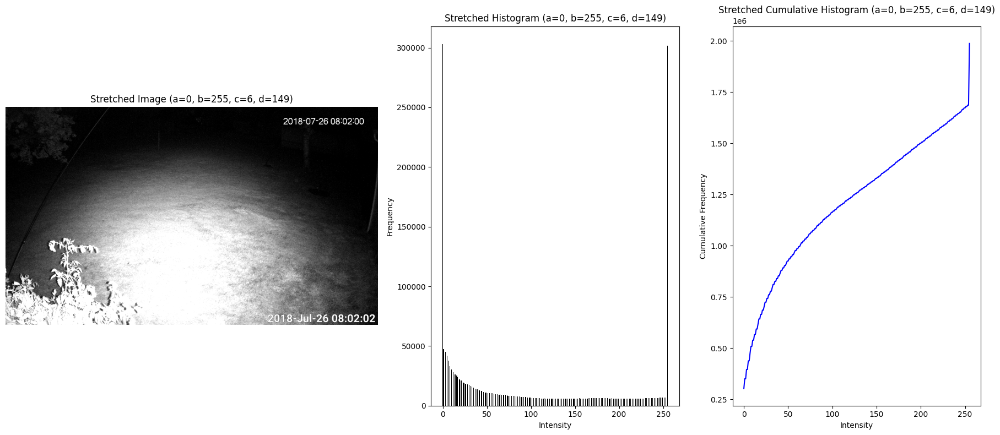

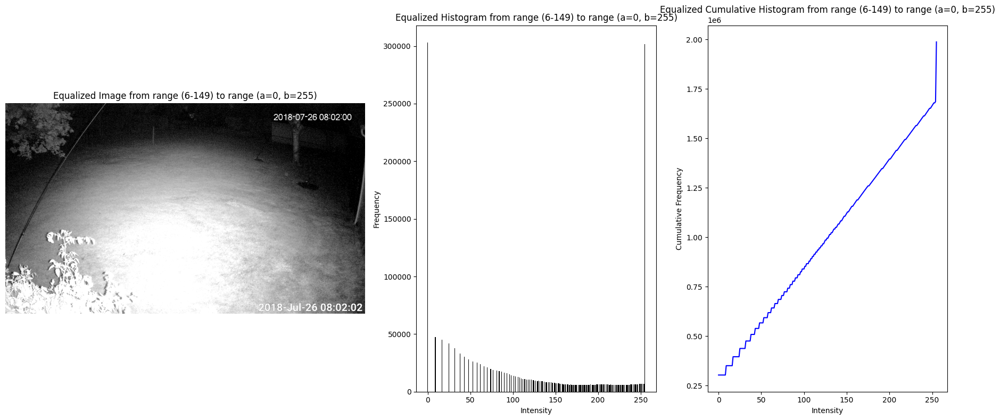

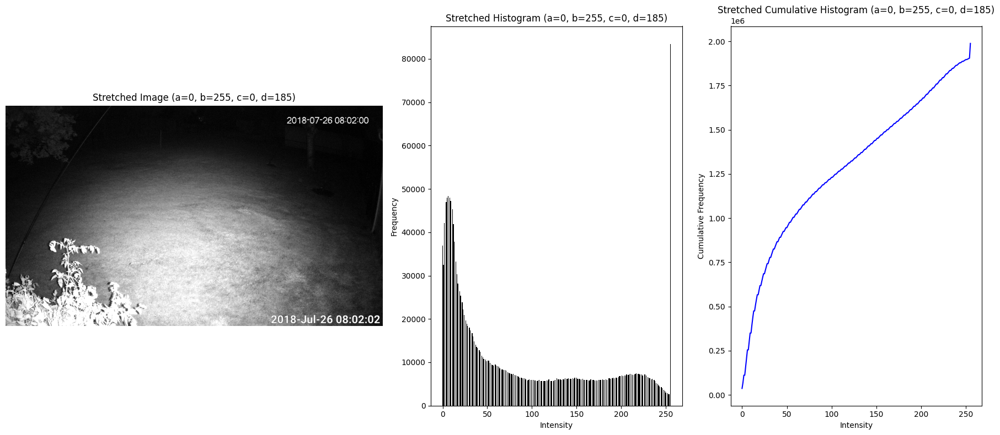

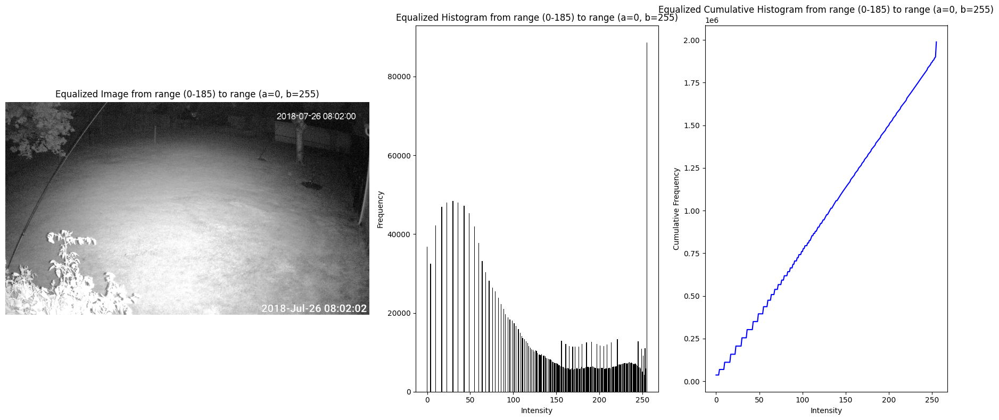

In [30]:
# Test image 6
test(img_path='./test6.jpg', percentages=percentages, a=a, b=b)

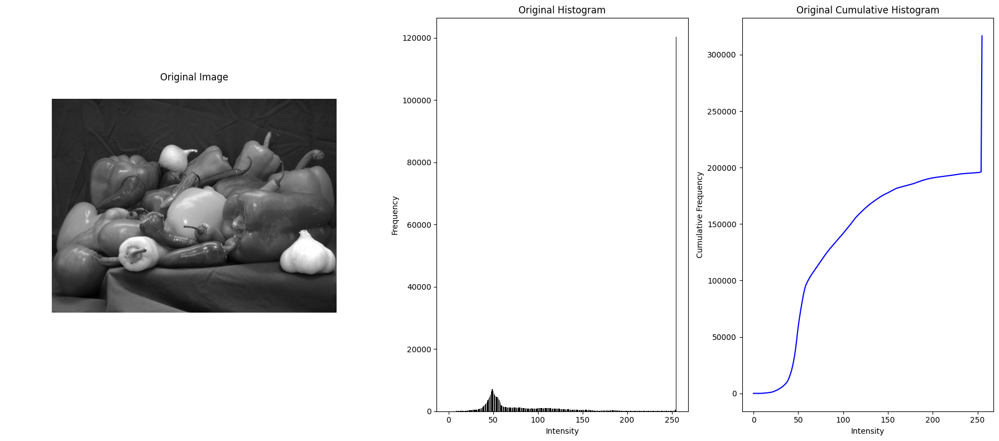

Intensities covering 5% of the image: 41 - 255
Intensities covering 10% of the image: 46 - 255
Intensities covering 15% of the image: 49 - 255
Intenities with maximum slope-like score: 254 - 255


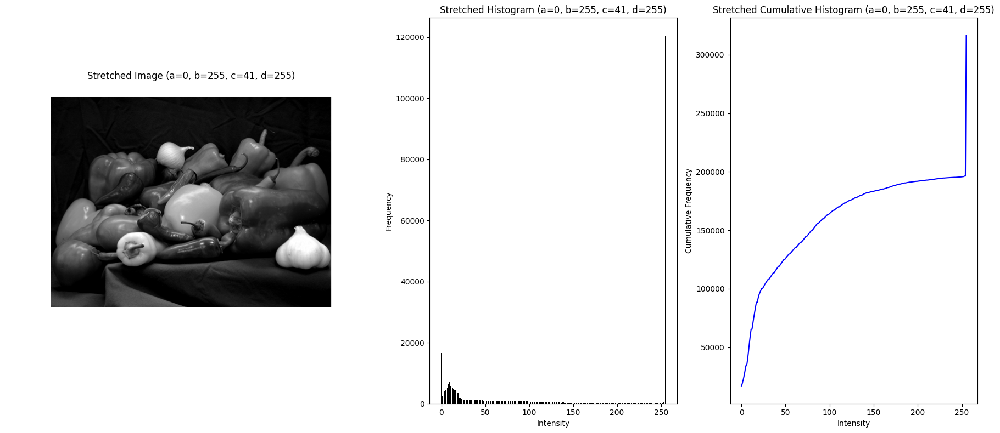

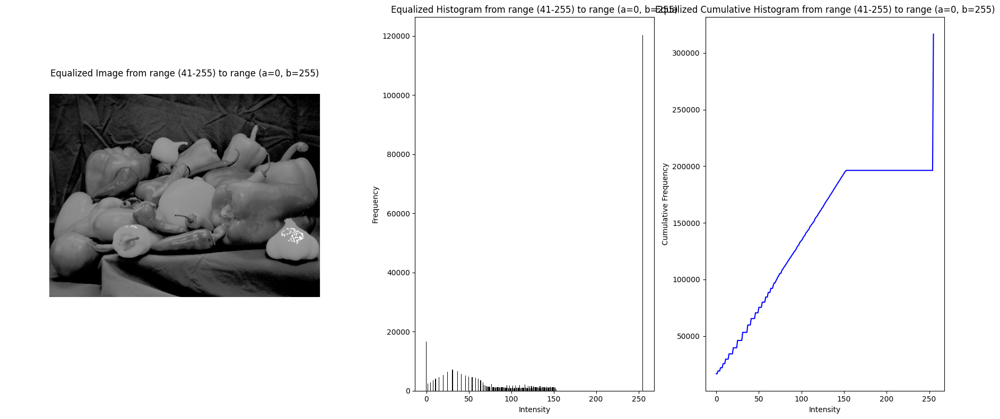

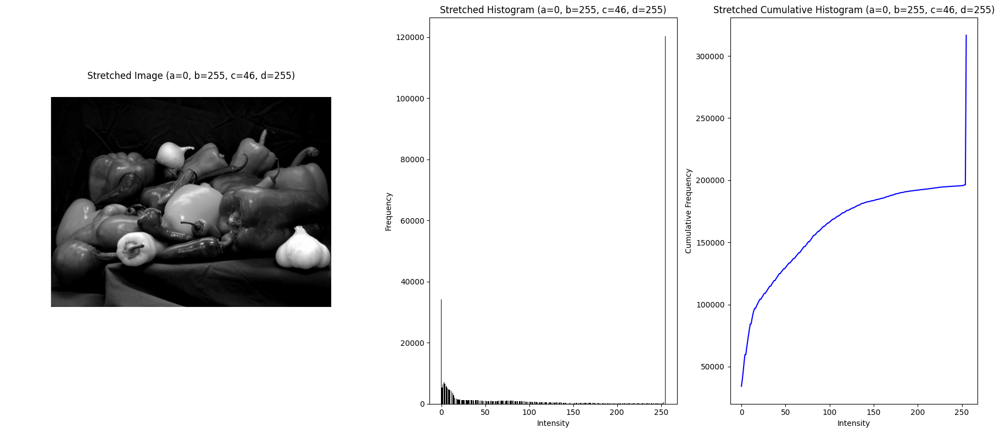

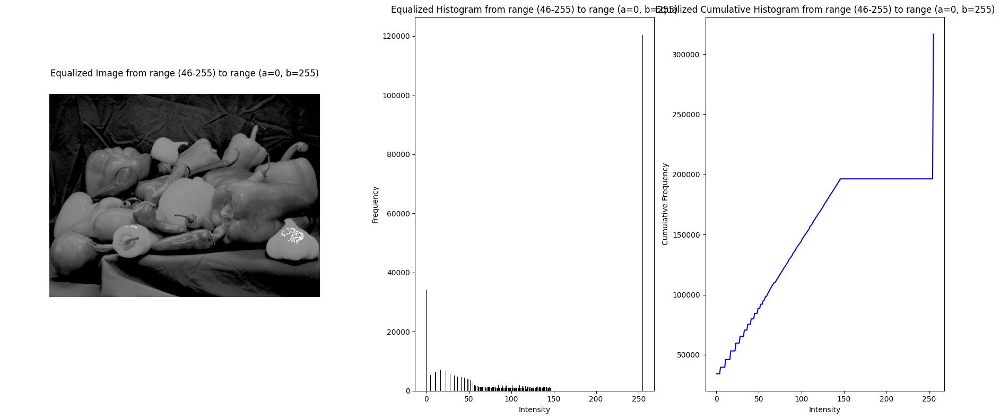

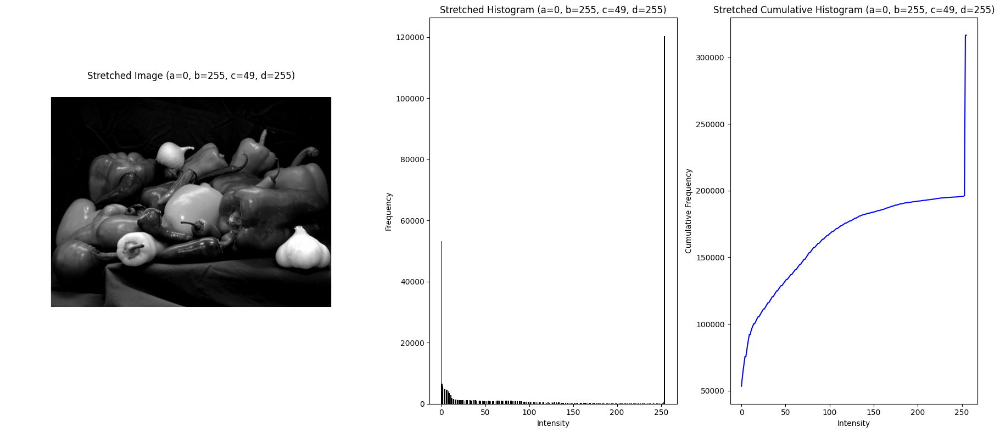

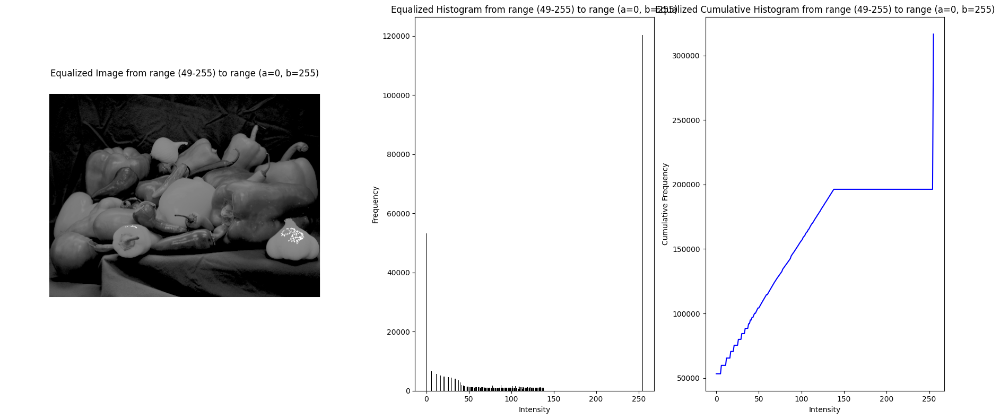

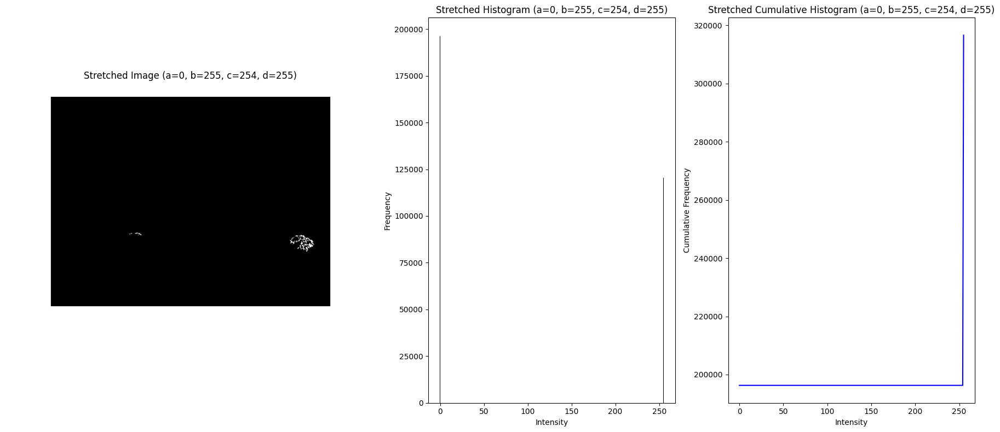

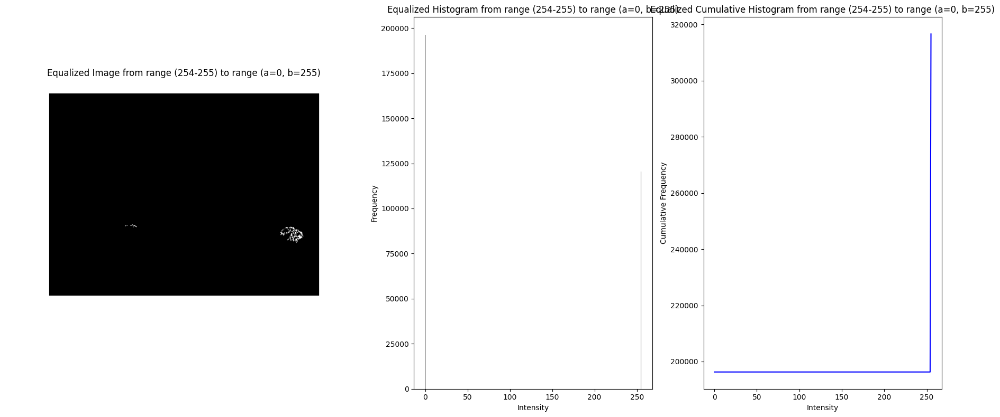

In [31]:
# Test image 7
test(img_path='./test7.png', percentages=percentages, a=a, b=b)

## Thank You!